In [1]:
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from collections import Counter
from nltk import WhitespaceTokenizer
import urllib
from wordcloud import WordCloud
from konlpy.tag import Okt

#  맷플롯립 전역폰트설정 해놓깅
mpl.rcParams['axes.unicode_minus'] = False
mpl.rcParams['font.family'] = "AppleGothic"

In [3]:
# 데이터 읽기
df = pd.read_csv('/Users/sky/class_python/3. EDA/it_news_real.csv', index_col=0)
df.head(3)

,title,date,link,content
0,"[증시이슈] 연이은 빅딜에도 사흘 내리 하락한 CJ ENM, 왜?",2021.11.25,https://economist.co.kr/2021/11/25/it/general/...,분할 법인에 예능·드라마·영화·애니메이션 모두 넘기면… 미국 LA 스테이플스...
1,"[팩플] 다들 반대할 때 ""카카오페이 해보자""한 류영준, 카카오 이끈다",2021.11.25,https://www.joongang.co.kr/article/25026933,카카오의 공동대표로 내정된 류영준(왼쪽) 내정자와 여민수(오른쪽) 대표. 카카오 제...
2,"LG그룹 COO로 권봉석 부회장, LG전자 대표는 조주완 사장",1818.12.12,http://www.etnews.com/20211125000208,"권봉석 LG전자 대표이사가 부회장으로 승진, ㈜LG 최고운영책임자(COO)로 선임됐..."


In [4]:
df = df[['title','content']]
df

,title,content
0,"[증시이슈] 연이은 빅딜에도 사흘 내리 하락한 CJ ENM, 왜?",분할 법인에 예능·드라마·영화·애니메이션 모두 넘기면… 미국 LA 스테이플스...
1,"[팩플] 다들 반대할 때 ""카카오페이 해보자""한 류영준, 카카오 이끈다",카카오의 공동대표로 내정된 류영준(왼쪽) 내정자와 여민수(오른쪽) 대표. 카카오 제...
2,"LG그룹 COO로 권봉석 부회장, LG전자 대표는 조주완 사장","권봉석 LG전자 대표이사가 부회장으로 승진, ㈜LG 최고운영책임자(COO)로 선임됐..."
3,BM 전문가 여민수-개발자 출신 CEO 류영준 시너지,카카오 내년 3월 여민수-류영준 공동대표 체제카카오커머스와 카카오페이 등 쇼핑+결제...
4,"롯데그룹, 이동우 부회장式 혁신에 힘 싣는다",이동우 롯데지주 대표이사 부회장.(사진=롯데.)롯데그룹은 2022년 정기 임원인사에...
...,...,...
995,오징어게임 대박…넷플릭스 한국 월이용자 1000만 육박,'오징어게임'으로 흥행에 성공한 글로벌 온라인동영상서비스(OTT) 넷플릭스의 한국 ...
996,"5대 외국계 IT기업 소비자 불만 상담, 10건 중 7건이 애플",경향신문] 애플스토어에 설치된 애플 로고. 로이터연합뉴스최근 5년간 주요 외국계 정...
997,[일잘러의 협업툴]②잔디·슬랙…MBTI처럼 '우리 회사'에 딱 맞는 툴은?,"코로나19 이전에는 마이크로소프트(MS)의 워드, 엑셀, 파워포인트만 잘 해도 일잘..."
998,세금 내는 법 더 편해질까…‘국세 간편결제’ 법안 나왔다,"윤관석 의원, 19일 국세징수법 개정안 대표 발의지방세 납부 때만 가능했던 간편결제..."


In [6]:
tokenizer = WhitespaceTokenizer()

In [7]:

tokens1 = tokenizer.tokenize(' '.join(df['title']))
counter1 = Counter(tokens1)
counter1.most_common(10)

[('美', 32),
 ('넷플릭스', 27),
 ('5G', 27),
 ('메타버스', 27),
 ('첫', 26),
 ('더', 23),
 ('세계', 23),
 ('반도체', 22),
 ('개발', 22),
 ('기술', 21)]

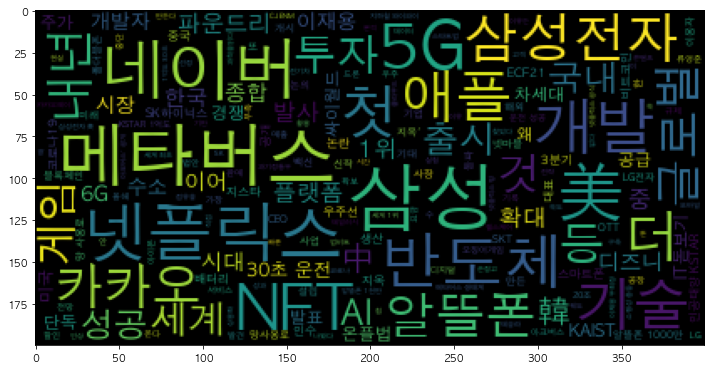

In [5]:
wc = WordCloud(font_path='../Library/Fonts/AppleGothic.ttf')
result = wc.generate(' '.join(tokens1))

plt.figure(figsize=(12,12))
plt.imshow(result)
plt.show()

In [8]:
tokens2 = tokenizer.tokenize(' '.join(df['content']))
tokens2

['분할',
 '법인에',
 '예능·드라마·영화·애니메이션',
 '모두',
 '넘기면…',
 '미국',
 'LA',
 '스테이플스센터에서',
 '열린',
 'CJ',
 'ENM',
 '케이콘',
 '콘서트',
 '공연',
 '모습.',
 '[사진',
 'CJ그룹]',
 '대규모',
 '인수',
 '건이',
 '연달아',
 '나온',
 'CJ',
 'ENM이지만,',
 '주가는',
 '사흘',
 '내리',
 '하락세를',
 '면치',
 '못하고',
 '있다.',
 '수요일까지',
 '10.80%',
 '떨어진',
 '데',
 '이어',
 '25일에도',
 '6.96%',
 '하락했다.',
 '이날(25일)',
 'CJ',
 'ENM',
 '주가는',
 '14만9700원에',
 '거래를',
 '마쳤다.',
 '투자자',
 '사이에선',
 '예상',
 '밖이라는',
 '반응이',
 '나온다.',
 '호재들이',
 '있었기',
 '때문이다.',
 '19일엔',
 '미국',
 '할리우드의',
 '대형',
 '스튜디오를,',
 '21일엔',
 '국내',
 '최대',
 '매니지먼트사인',
 'SM엔터테인먼트를',
 '인수한다는',
 '보도가',
 '나왔다.',
 '모두',
 '성사되면',
 '콘텐트',
 '기획·유통',
 '역량을',
 '한',
 '단계',
 '끌어올릴',
 '만하다.',
 '불안감의',
 '원천은',
 '분할',
 '법인이다.',
 'CJ',
 'ENM은',
 '19일',
 '글로벌',
 '콘텐트',
 '제작',
 '역량을',
 '강화하기',
 '위해',
 '예능·드라마·영화·애니메이션',
 '사업',
 '부문을',
 '묶어서',
 '신설',
 '법인으로',
 '넘긴다고',
 '밝혔다.',
 '빠르게',
 '성장하는',
 '사업',
 '부문이',
 '모두',
 '새',
 '법인에',
 '넘어가면',
 'CJ',
 'ENM으로선',
 '성장',
 '동력이',
 '없다는',
 '것이',
 '시장에서',
 '불안해하는',
 '이유다.',
 '이기훈',
 '하나

In [9]:
okt = Okt()

In [25]:
basket = []
for data in df['content']:
    text = okt.pos(data)
    basket.append(text)

In [26]:
print(len(basket))
basket

1000


[[('분할', 'Noun'),
  ('법인', 'Noun'),
  ('에', 'Josa'),
  ('예능', 'Noun'),
  ('·', 'Punctuation'),
  ('드라마', 'Noun'),
  ('·', 'Punctuation'),
  ('영화', 'Noun'),
  ('·', 'Punctuation'),
  ('애니메이션', 'Noun'),
  ('모두', 'Noun'),
  ('넘기면', 'Verb'),
  ('…', 'Punctuation'),
  ('미국', 'Noun'),
  ('LA', 'Alpha'),
  ('스테이플스', 'Noun'),
  ('센터', 'Noun'),
  ('에서', 'Josa'),
  ('열린', 'Verb'),
  ('CJ', 'Alpha'),
  ('ENM', 'Alpha'),
  ('케이', 'Noun'),
  ('콘', 'Noun'),
  ('콘서트', 'Noun'),
  ('공연', 'Noun'),
  ('모습', 'Noun'),
  ('.', 'Punctuation'),
  ('[', 'Punctuation'),
  ('사진', 'Noun'),
  ('CJ', 'Alpha'),
  ('그룹', 'Noun'),
  (']', 'Punctuation'),
  ('대규모', 'Noun'),
  ('인수', 'Noun'),
  ('건', 'Noun'),
  ('이', 'Josa'),
  ('연달', 'Noun'),
  ('아', 'Josa'),
  ('나온', 'Verb'),
  ('CJ', 'Alpha'),
  ('ENM', 'Alpha'),
  ('이지만', 'Josa'),
  (',', 'Punctuation'),
  ('주가', 'Noun'),
  ('는', 'Josa'),
  ('사흘', 'Noun'),
  ('내리', 'Verb'),
  ('하락', 'Noun'),
  ('세', 'Noun'),
  ('를', 'Josa'),
  ('면치', 'Noun'),
  ('못', 'Noun'),
  ('하고

In [20]:
# 불용어 사전
# stop_words = open('/Users/sky/class_python/3. EDA/StopWords.txt', 'r', encoding='utf8')

In [22]:
# nouns = []

# for b in basket:
#     for word, t in b:
#         if t != stop_words:
#             nouns.append(nouns)
            
# len(nouns)

653872

In [28]:
# 선생님 코드
# len(basket)
nouns = []
for b in basket:
    for word, t in b:
        if t == 'Noun':
            nouns.append(word)
len(nouns)

321520

In [29]:
nouns

['분할',
 '법인',
 '예능',
 '드라마',
 '영화',
 '애니메이션',
 '모두',
 '미국',
 '스테이플스',
 '센터',
 '케이',
 '콘',
 '콘서트',
 '공연',
 '모습',
 '사진',
 '그룹',
 '대규모',
 '인수',
 '건',
 '연달',
 '주가',
 '사흘',
 '하락',
 '세',
 '면치',
 '못',
 '수요일',
 '데',
 '하락',
 '날',
 '주가',
 '거래',
 '투자자',
 '사이',
 '예상',
 '밖',
 '반응',
 '호재',
 '때문',
 '미국',
 '할리우드',
 '대형',
 '스튜디오',
 '국내',
 '최대',
 '매니지먼트사',
 '엔터테인먼트',
 '인수',
 '보도',
 '모두',
 '성사',
 '콘텐트',
 '기획',
 '유통',
 '역량',
 '단계',
 '만하',
 '불안감',
 '원천',
 '분할',
 '법인',
 '은',
 '글로벌',
 '콘텐트',
 '제작',
 '역량',
 '위해',
 '예능',
 '드라마',
 '영화',
 '애니메이션',
 '사업',
 '부문',
 '신설',
 '법인',
 '사업',
 '부문',
 '모두',
 '새',
 '법인',
 '성장',
 '동력',
 '것',
 '시장',
 '이유',
 '이기',
 '훈',
 '하나',
 '금융투자',
 '애널',
 '리스트',
 '최소한',
 '두',
 '회사',
 '커머스',
 '전략',
 '모든',
 '성장',
 '전략',
 '분할',
 '점',
 '며',
 '목표',
 '주가',
 '카카오',
 '대표',
 '내정',
 '류영준',
 '왼쪽',
 '내정자',
 '민수',
 '오른쪽',
 '대표',
 '카카오',
 '제공',
 '카카오',
 '차기',
 '대표',
 '개발자',
 '출신',
 '류영준',
 '카카오',
 '페이',
 '대표',
 '내정',
 '류',
 '내정자',
 '전',
 '카카오',
 '입사',
 '핀',
 '테크',
 '기업',
 '카카오',
 '페이',
 '성공',
 '상장',
 '주

In [30]:
counter1 = Counter(nouns)
counter1.most_common(100)

[('것', 3744),
 ('등', 3224),
 ('수', 3141),
 ('이', 2087),
 ('기술', 1904),
 ('위', 1484),
 ('를', 1471),
 ('서비스', 1466),
 ('게임', 1450),
 ('고', 1429),
 ('시장', 1276),
 ('전자', 1215),
 ('개발', 1154),
 ('통해', 1124),
 ('지난', 1095),
 ('대표', 1066),
 ('의', 1049),
 ('버스', 1035),
 ('국내', 1034),
 ('기업', 1014),
 ('플랫폼', 1008),
 ('사업', 990),
 ('메타', 975),
 ('말', 961),
 ('글로벌', 951),
 ('미국', 943),
 ('한국', 930),
 ('반도체', 897),
 ('제공', 893),
 ('투자', 889),
 ('카카오', 856),
 ('콘텐츠', 848),
 ('사용', 827),
 ('며', 826),
 ('위해', 809),
 ('알뜰폰', 802),
 ('및', 743),
 ('네이버', 740),
 ('세계', 735),
 ('대한', 730),
 ('더', 720),
 ('삼성', 717),
 ('명', 680),
 ('중', 680),
 ('이용', 680),
 ('올해', 671),
 ('넷플릭스', 664),
 ('계획', 660),
 ('사진', 656),
 ('로', 656),
 ('약', 656),
 ('망', 656),
 ('개', 651),
 ('디지털', 642),
 ('기반', 638),
 ('이번', 635),
 ('전', 633),
 ('출시', 619),
 ('진행', 617),
 ('업계', 614),
 ('과', 596),
 ('내년', 594),
 ('최근', 593),
 ('산업', 591),
 ('이상', 588),
 ('생산', 586),
 ('활용', 585),
 ('통신', 580),
 ('확대', 567),
 ('현재', 565),
 ('정부', 

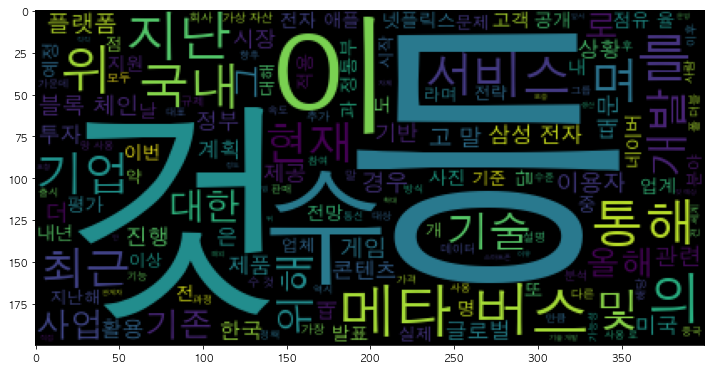

In [31]:
wc = WordCloud(font_path='../Library/Fonts/AppleGothic.ttf')
result = wc.generate(' '.join(nouns))

plt.figure(figsize=(12,12))
plt.imshow(result)
plt.show()